In [1]:
! pip install qeds fiona geopandas xgboost gensim folium pyLDAvis descartes

  Using cached xgboost-1.0.2-py3-none-manylinux1_x86_64.whl (109.7 MB)
  Using cached gensim-3.8.1-cp37-cp37m-manylinux1_x86_64.whl (24.2 MB)
Processing /home/jupyter/.cache/pip/wheels/3b/fb/41/e32e5312da9f440d34c4eff0d2207b46dc9332a7b931ef1e89/pyLDAvis-2.1.2-py2.py3-none-any.whl
Processing /home/jupyter/.cache/pip/wheels/1f/e5/fc/7412935a7184efc8ad377e948c81b1cc99b6a02eb8dc7c918c/smart_open-1.10.0-py3-none-any.whl
Processing /home/jupyter/.cache/pip/wheels/56/b0/fe/4410d17b32f1f0c3cf54cdfb2bc04d7b4b8f4ae377e2229ba0/future-0.18.2-py3-none-any.whl
Processing /home/jupyter/.cache/pip/wheels/3c/33/97/805b282e129f60bb4e87cea622338f30b65f21eaf65219971f/funcy-1.14-py2.py3-none-any.whl
     |████████████████████████████████| 128 kB 6.4 MB/s eta 0:00:01
  Using cached google_cloud_storage-1.26.0-py2.py3-none-any.whl (75 kB)
  Using cached s3transfer-0.3.3-py2.py3-none-any.whl (69 kB)
     |████████████████████████████████| 6.0 MB 9.4 MB/s eta 0:00:01
  Using cached jmespath-0.9.5-py2.py3-none-

In [2]:
import geopandas as gpd
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from shapely.geometry import Point
import plotly.express as px

%matplotlib inline
# activate plot theme
import qeds
qeds.themes.mpl_style();

I start by uploading my thesis data. For my thesis, I am interested in understanding how increasing the intensity of the measure of fatalities affects support for Duterte's party, PDP Laban, in the most recent mayoral elections. Since Duterte was elected in 2016, the Philippines has become a hotbed for extra judicial killings of drug suspects. There's a lot of literature in economics about the effect of conflict on political and economic outcomes. One really important paper for my thesis is done by Luisa Blanco in 2012, who finds that increased perceptions of insecurity(resulting from exposure to violent crime) leads to distrust in the government and also increased palatability of authoritarianism(partially because of its perceived efficiency in dealing with crime). The Philippines offers an interesting context: On the one hand, the majority of the extra-judicial killings have been comitted or encouraged by the state towards mostly low income Filipinos. This could lead to  Filipinos feeling less safe and distrusting the government. On the other hand, the Philippines has a long history of dealing with inefficient courts, and so the drug war could be welcomed as an efficient way of dealing with the drug trade. The purpose of my thesis is to see which effect dominates in the Philippine setting.

In [4]:

#read thesis data here

PH = pd.read_stata("Collapsed merged with controls and dist!(unmatched munis dropped) 2.dta")

#generating the coordinates
PH["Coordinates"] = list(zip(PH.longitude, PH.latitude))
PH.head()
PH["Coordinates"] = PH["Coordinates"].apply(Point)
PH.head()

,province,muni,PDPpercent,region,region_code,province_code,municipality_city_code,longitude,latitude,location,...,lon_a_5,lat_a_5,d_a_5,PDPran,FPDP,pi_g,fatalities_pc,fatalities_p_c,pi_a,Coordinates
0,ABRA,BANGUED,0.101855,Cordillera Administrative Region (CAR),PH140000000,PH140100000,PH140101000,120.600914,17.611204,POINT(120.600912102 17.6112035614),...,120.991997,14.545,341.874815,1.0,6.0,-0.386866,0.000125,1.245770,0.126267,POINT (120.6009140014648 17.61120414733887)
1,ABRA,BOLINEY,0.000000,Cordillera Administrative Region (CAR),PH140000000,PH140100000,PH140102000,120.864738,17.378698,POINT(120.864738788 17.3786990212),...,120.991997,14.545,313.868504,0.0,0.0,-0.627300,0.000000,0.000000,0.451233,POINT (120.8647384643555 17.37869834899902)
2,ABRA,BUCAY,0.053107,Cordillera Administrative Region (CAR),PH140000000,PH140100000,PH140103000,120.719849,17.523537,POINT(120.719846281 17.523537522),...,120.991997,14.545,330.886511,1.0,1.0,-0.562465,0.000058,0.584283,0.298767,POINT (120.7198486328125 17.52353668212891)
3,ABRA,BUCLOC,0.047902,Cordillera Administrative Region (CAR),PH140000000,PH140100000,PH140104000,120.848061,17.436989,POINT(120.848063524 17.4369884989),...,120.991997,14.545,320.394546,1.0,0.0,-0.727650,0.000000,0.000000,0.467700,POINT (120.8480606079102 17.43698883056641)
4,ABRA,DAGUIOMAN,0.007278,Cordillera Administrative Region (CAR),PH140000000,PH140100000,PH140105000,120.952278,17.449829,POINT(120.952276395 17.4498298787),...,120.991997,14.545,321.473186,1.0,0.0,-0.056885,0.000000,0.000000,0.331700,POINT (120.952278137207 17.4498291015625)


PDP percent is my variable for the vote share of Duterte's party's candidates.

Next, I upload the stanford shape file that contains the polygon data at the municipality level.

In [5]:
PHshape2 = gpd.read_file("PHL_stanford.shp")

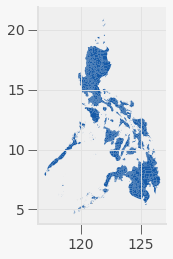

In [6]:
PHshape2.plot()

In [7]:
#get the world map:

world = gpd.read_file(gpd.datasets.get_path("naturalearth_lowres"))
world = world.set_index("iso_a3")


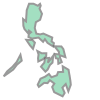

In [8]:
world.loc["PHL",'geometry']

In [9]:
PH.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1615 entries, 0 to 1614
Data columns (total 63 columns):
 #   Column                  Non-Null Count  Dtype   
---  ------                  --------------  -----   
 0   province                1615 non-null   object  
 1   muni                    1615 non-null   object  
 2   PDPpercent              1615 non-null   float32 
 3   region                  1615 non-null   object  
 4   region_code             1615 non-null   object  
 5   province_code           1615 non-null   object  
 6   municipality_city_code  1615 non-null   object  
 7   longitude               1615 non-null   float32 
 8   latitude                1615 non-null   float32 
 9   location                1615 non-null   object  
 10  muni_code_numeric       1615 non-null   int32   
 11  p_2009                  1615 non-null   float32 
 12  p_2012                  1615 non-null   float32 
 13  p_2015                  1615 non-null   float32 
 14  var26                   

I now convert my thesis data to a geopanda data frame so that I can merge using geometric locations.

In [10]:
PHvote = gpd.GeoDataFrame(PH, geometry="Coordinates")

PHvote



,province,muni,PDPpercent,region,region_code,province_code,municipality_city_code,longitude,latitude,location,...,lon_a_5,lat_a_5,d_a_5,PDPran,FPDP,pi_g,fatalities_pc,fatalities_p_c,pi_a,Coordinates
0,ABRA,BANGUED,0.101855,Cordillera Administrative Region (CAR),PH140000000,PH140100000,PH140101000,120.600914,17.611204,POINT(120.600912102 17.6112035614),...,120.991997,14.545,341.874815,1.0,6.0,-0.386866,0.000125,1.245770,0.126267,POINT (120.60091 17.61120)
1,ABRA,BOLINEY,0.000000,Cordillera Administrative Region (CAR),PH140000000,PH140100000,PH140102000,120.864738,17.378698,POINT(120.864738788 17.3786990212),...,120.991997,14.545,313.868504,0.0,0.0,-0.627300,0.000000,0.000000,0.451233,POINT (120.86474 17.37870)
2,ABRA,BUCAY,0.053107,Cordillera Administrative Region (CAR),PH140000000,PH140100000,PH140103000,120.719849,17.523537,POINT(120.719846281 17.523537522),...,120.991997,14.545,330.886511,1.0,1.0,-0.562465,0.000058,0.584283,0.298767,POINT (120.71985 17.52354)
3,ABRA,BUCLOC,0.047902,Cordillera Administrative Region (CAR),PH140000000,PH140100000,PH140104000,120.848061,17.436989,POINT(120.848063524 17.4369884989),...,120.991997,14.545,320.394546,1.0,0.0,-0.727650,0.000000,0.000000,0.467700,POINT (120.84806 17.43699)
4,ABRA,DAGUIOMAN,0.007278,Cordillera Administrative Region (CAR),PH140000000,PH140100000,PH140105000,120.952278,17.449829,POINT(120.952276395 17.4498298787),...,120.991997,14.545,321.473186,1.0,0.0,-0.056885,0.000000,0.000000,0.331700,POINT (120.95228 17.44983)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1610,ZAMBOANGA SIBUGAY,ROSELLER LIM,0.197443,Region IX (Zamboanga Peninsula),PH090000000,PH098300000,PH098312000,122.430687,7.702022,POINT(122.430683899 7.7020220193),...,124.442001,8.592,242.523021,1.0,0.0,-0.112825,0.000000,0.000000,0.489067,POINT (122.43069 7.70202)
1611,ZAMBOANGA SIBUGAY,SIAY,0.260228,Region IX (Zamboanga Peninsula),PH090000000,PH098300000,PH098313000,122.876854,7.734716,POINT(122.876851077 7.73471573608),...,124.442001,8.592,196.818101,1.0,0.0,-0.042893,0.000000,0.000000,0.440700,POINT (122.87685 7.73472)
1612,ZAMBOANGA SIBUGAY,TALUSAN,0.178658,Region IX (Zamboanga Peninsula),PH090000000,PH098300000,PH098314000,122.884216,7.334711,POINT(122.884218322 7.3347104573),...,124.442001,8.592,220.979871,1.0,0.0,-0.158900,0.000000,0.000000,0.606933,POINT (122.88422 7.33471)
1613,ZAMBOANGA SIBUGAY,TITAY,0.000000,Region IX (Zamboanga Peninsula),PH090000000,PH098300000,PH098315000,122.517639,7.845210,POINT(122.517641 7.84521002867),...,124.442001,8.592,227.549967,0.0,0.0,0.017960,0.000000,0.000000,0.414100,POINT (122.51764 7.84521)


In the cells below, I merge my thesis data with the shape file I need to plot the municipalities and the cities. I tried using all 3 versions of "op" ; the other 2 are "contains" and "within". "Intersects" gives me the best merge.

In [11]:
##merging the spacial data with the thesis data

PHmerge = gpd.sjoin(PHvote, PHshape2, how = "right", op = 'intersects')
PHmerge


,index_left,province,muni,PDPpercent,region,region_code,province_code,municipality_city_code,longitude,latitude,...,lon_a_5,lat_a_5,d_a_5,PDPran,FPDP,pi_g,fatalities_pc,fatalities_p_c,pi_a,geometry
0,0.0,ABRA,BANGUED,0.101855,Cordillera Administrative Region (CAR),PH140000000,PH140100000,PH140101000,120.600914,17.611204,...,120.991997,14.545,341.874815,1.0,6.0,-0.386866,0.000125,1.245770,0.126267,"POLYGON ((120.61553 17.62360, 120.61870 17.623..."
1,1.0,ABRA,BOLINEY,0.000000,Cordillera Administrative Region (CAR),PH140000000,PH140100000,PH140102000,120.864738,17.378698,...,120.991997,14.545,313.868504,0.0,0.0,-0.627300,0.000000,0.000000,0.451233,"POLYGON ((120.90749 17.41933, 120.92464 17.413..."
2,2.0,ABRA,BUCAY,0.053107,Cordillera Administrative Region (CAR),PH140000000,PH140100000,PH140103000,120.719849,17.523537,...,120.991997,14.545,330.886511,1.0,1.0,-0.562465,0.000058,0.584283,0.298767,"POLYGON ((120.74548 17.57671, 120.75101 17.575..."
3,3.0,ABRA,BUCLOC,0.047902,Cordillera Administrative Region (CAR),PH140000000,PH140100000,PH140104000,120.848061,17.436989,...,120.991997,14.545,320.394546,1.0,0.0,-0.727650,0.000000,0.000000,0.467700,"POLYGON ((120.82477 17.41721, 120.78956 17.416..."
4,4.0,ABRA,DAGUIOMAN,0.007278,Cordillera Administrative Region (CAR),PH140000000,PH140100000,PH140105000,120.952278,17.449829,...,120.991997,14.545,321.473186,1.0,0.0,-0.056885,0.000000,0.000000,0.331700,"POLYGON ((120.98141 17.50534, 120.98367 17.504..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1579,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"MULTIPOLYGON (((120.23167 14.85611, 120.23222 ..."
1595,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"POLYGON ((123.39980 8.44444, 123.40269 8.44411..."
1614,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"POLYGON ((123.54957 8.21537, 123.54903 8.20592..."
1617,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"POLYGON ((123.18555 7.84652, 123.18510 7.84630..."


I clean the merged data set a little bit to only retain matched observations.

In [12]:
## retaining only the matched municipalities

PHmerge = PHmerge[PHmerge.classification == 'Community']
PHmerge

,index_left,province,muni,PDPpercent,region,region_code,province_code,municipality_city_code,longitude,latitude,...,lon_a_5,lat_a_5,d_a_5,PDPran,FPDP,pi_g,fatalities_pc,fatalities_p_c,pi_a,geometry
0,0.0,ABRA,BANGUED,0.101855,Cordillera Administrative Region (CAR),PH140000000,PH140100000,PH140101000,120.600914,17.611204,...,120.991997,14.545,341.874815,1.0,6.0,-0.386866,0.000125,1.245770,0.126267,"POLYGON ((120.61553 17.62360, 120.61870 17.623..."
1,1.0,ABRA,BOLINEY,0.000000,Cordillera Administrative Region (CAR),PH140000000,PH140100000,PH140102000,120.864738,17.378698,...,120.991997,14.545,313.868504,0.0,0.0,-0.627300,0.000000,0.000000,0.451233,"POLYGON ((120.90749 17.41933, 120.92464 17.413..."
2,2.0,ABRA,BUCAY,0.053107,Cordillera Administrative Region (CAR),PH140000000,PH140100000,PH140103000,120.719849,17.523537,...,120.991997,14.545,330.886511,1.0,1.0,-0.562465,0.000058,0.584283,0.298767,"POLYGON ((120.74548 17.57671, 120.75101 17.575..."
3,3.0,ABRA,BUCLOC,0.047902,Cordillera Administrative Region (CAR),PH140000000,PH140100000,PH140104000,120.848061,17.436989,...,120.991997,14.545,320.394546,1.0,0.0,-0.727650,0.000000,0.000000,0.467700,"POLYGON ((120.82477 17.41721, 120.78956 17.416..."
4,4.0,ABRA,DAGUIOMAN,0.007278,Cordillera Administrative Region (CAR),PH140000000,PH140100000,PH140105000,120.952278,17.449829,...,120.991997,14.545,321.473186,1.0,0.0,-0.056885,0.000000,0.000000,0.331700,"POLYGON ((120.98141 17.50534, 120.98367 17.504..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1647,1610.0,ZAMBOANGA SIBUGAY,ROSELLER LIM,0.197443,Region IX (Zamboanga Peninsula),PH090000000,PH098300000,PH098312000,122.430687,7.702022,...,124.442001,8.592,242.523021,1.0,0.0,-0.112825,0.000000,0.000000,0.489067,"MULTIPOLYGON (((122.54519 7.68240, 122.54472 7..."
1648,1611.0,ZAMBOANGA SIBUGAY,SIAY,0.260228,Region IX (Zamboanga Peninsula),PH090000000,PH098300000,PH098313000,122.876854,7.734716,...,124.442001,8.592,196.818101,1.0,0.0,-0.042893,0.000000,0.000000,0.440700,"MULTIPOLYGON (((122.80055 7.73917, 122.80083 7..."
1649,1612.0,ZAMBOANGA SIBUGAY,TALUSAN,0.178658,Region IX (Zamboanga Peninsula),PH090000000,PH098300000,PH098314000,122.884216,7.334711,...,124.442001,8.592,220.979871,1.0,0.0,-0.158900,0.000000,0.000000,0.606933,"MULTIPOLYGON (((122.91917 7.34111, 122.91861 7..."
1650,1613.0,ZAMBOANGA SIBUGAY,TITAY,0.000000,Region IX (Zamboanga Peninsula),PH090000000,PH098300000,PH098315000,122.517639,7.845210,...,124.442001,8.592,227.549967,0.0,0.0,0.017960,0.000000,0.000000,0.414100,"POLYGON ((122.68086 7.88831, 122.68091 7.88682..."


Before I can make the map, I need to convert my merged data set into a geopanda data frame.

In [13]:
PHmerge = gpd.GeoDataFrame(PHmerge, geometry="geometry")
PHmerge

,index_left,province,muni,PDPpercent,region,region_code,province_code,municipality_city_code,longitude,latitude,...,lon_a_5,lat_a_5,d_a_5,PDPran,FPDP,pi_g,fatalities_pc,fatalities_p_c,pi_a,geometry
0,0.0,ABRA,BANGUED,0.101855,Cordillera Administrative Region (CAR),PH140000000,PH140100000,PH140101000,120.600914,17.611204,...,120.991997,14.545,341.874815,1.0,6.0,-0.386866,0.000125,1.245770,0.126267,"POLYGON ((120.61553 17.62360, 120.61870 17.623..."
1,1.0,ABRA,BOLINEY,0.000000,Cordillera Administrative Region (CAR),PH140000000,PH140100000,PH140102000,120.864738,17.378698,...,120.991997,14.545,313.868504,0.0,0.0,-0.627300,0.000000,0.000000,0.451233,"POLYGON ((120.90749 17.41933, 120.92464 17.413..."
2,2.0,ABRA,BUCAY,0.053107,Cordillera Administrative Region (CAR),PH140000000,PH140100000,PH140103000,120.719849,17.523537,...,120.991997,14.545,330.886511,1.0,1.0,-0.562465,0.000058,0.584283,0.298767,"POLYGON ((120.74548 17.57671, 120.75101 17.575..."
3,3.0,ABRA,BUCLOC,0.047902,Cordillera Administrative Region (CAR),PH140000000,PH140100000,PH140104000,120.848061,17.436989,...,120.991997,14.545,320.394546,1.0,0.0,-0.727650,0.000000,0.000000,0.467700,"POLYGON ((120.82477 17.41721, 120.78956 17.416..."
4,4.0,ABRA,DAGUIOMAN,0.007278,Cordillera Administrative Region (CAR),PH140000000,PH140100000,PH140105000,120.952278,17.449829,...,120.991997,14.545,321.473186,1.0,0.0,-0.056885,0.000000,0.000000,0.331700,"POLYGON ((120.98141 17.50534, 120.98367 17.504..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1647,1610.0,ZAMBOANGA SIBUGAY,ROSELLER LIM,0.197443,Region IX (Zamboanga Peninsula),PH090000000,PH098300000,PH098312000,122.430687,7.702022,...,124.442001,8.592,242.523021,1.0,0.0,-0.112825,0.000000,0.000000,0.489067,"MULTIPOLYGON (((122.54519 7.68240, 122.54472 7..."
1648,1611.0,ZAMBOANGA SIBUGAY,SIAY,0.260228,Region IX (Zamboanga Peninsula),PH090000000,PH098300000,PH098313000,122.876854,7.734716,...,124.442001,8.592,196.818101,1.0,0.0,-0.042893,0.000000,0.000000,0.440700,"MULTIPOLYGON (((122.80055 7.73917, 122.80083 7..."
1649,1612.0,ZAMBOANGA SIBUGAY,TALUSAN,0.178658,Region IX (Zamboanga Peninsula),PH090000000,PH098300000,PH098314000,122.884216,7.334711,...,124.442001,8.592,220.979871,1.0,0.0,-0.158900,0.000000,0.000000,0.606933,"MULTIPOLYGON (((122.91917 7.34111, 122.91861 7..."
1650,1613.0,ZAMBOANGA SIBUGAY,TITAY,0.000000,Region IX (Zamboanga Peninsula),PH090000000,PH098300000,PH098315000,122.517639,7.845210,...,124.442001,8.592,227.549967,0.0,0.0,0.017960,0.000000,0.000000,0.414100,"POLYGON ((122.68086 7.88831, 122.68091 7.88682..."


Finally, I graph the vote share in the Philippines by municipality in the 2019 Mayoral elections. 

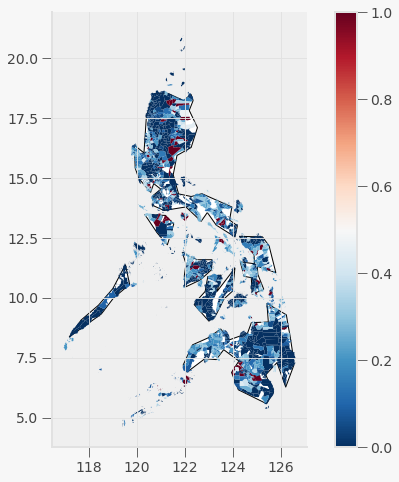

In [14]:
##map for PH

fig, gax = plt.subplots(figsize = (10,8))
#plot the Philippines!
world.query("name=='Philippines'").plot(ax=gax, edgecolor='black',color='white')


#plot the muicipalities
PHmerge.plot(ax=gax, column="PDPpercent", legend=True,cmap='RdBu_r')

The above results show that most municipalities don't have majority support for Duterte's party's mayoral candidates. The important thing though is that there is lots of variation in the municipality's vote shares for Duterte, which is a good thing.

I also try to graph the fatalities for the Philippines. I should note that most municipalities that observed at least one fatality have a relatively small count of fatalities(the mean of the fatalities variable in my data set is around 3). To scale the fatalities better on the map, I decide to use the log of fatalities instead of the count. Since the range in the count of fatalities is quite large(it goes from 0 to 428), some municipalities look as though they had no fatalities because of the way cmap scales the colouring. In my thesis, I include specifications where I use the count of fataltiies, and others where I include the log of fatalities.

Note: I chose to use a heat map for this visualisation since this is the same type of colour scheme Blanco(2012) uses for their homecide rate visualisations in their appendix.

In [60]:
PHmerge["log_fatalities"]=np.log(PHmerge["fatalities"]) 

/opt/conda/lib/python3.7/site-packages/pandas/core/series.py:679: RuntimeWarning:

divide by zero encountered in log



In [61]:
#cleaning the log fatalities variable
PHmerge["log_fatalities"] = np.nan_to_num(PHmerge["log_fatalities"], copy=True, nan=0.0, posinf=None, neginf=0)
PHmerge["log_fatalities"]

0       1.791759
1       0.000000
2       0.000000
3       0.000000
4       0.000000
          ...   
1647    0.000000
1648    0.000000
1649    0.000000
1650    0.000000
1651    0.693147
Name: log_fatalities, Length: 1613, dtype: float64

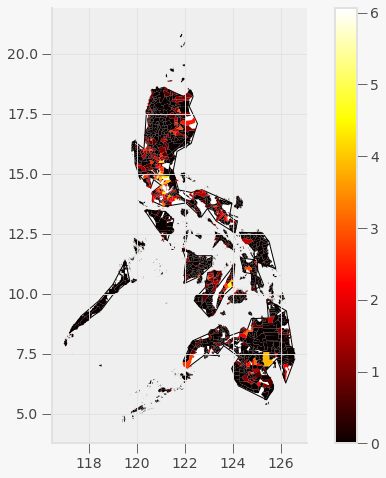

In [62]:
fig, gax = plt.subplots(figsize = (10,8))
#plot the Philippines!
world.query("name=='Philippines'").plot(ax=gax, edgecolor='black',color='white')


#plot the muicipalities
PHmerge.plot(ax=gax, column="log_fatalities", legend=True,cmap='hot')
 

This map is reassuring since there is a lot of geographic variation in the fatalities. If the fatalities were concerntrated in one specific region that would mean that I might have to limit my analysis to that region, which would severly limit my observations. Since the fatalities are relatively spread out throughout the country, I am able to make use of all the municipalities in my data set. 

For reference, here is the map where I use the count of fatalities instead:

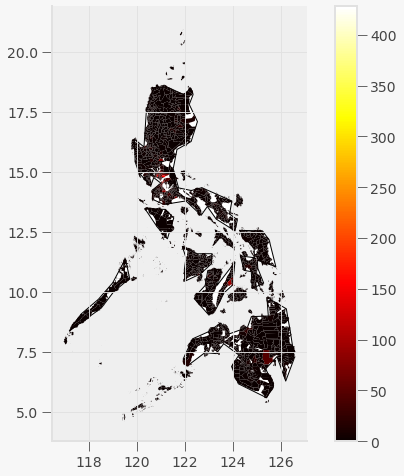

In [63]:
fig, gax = plt.subplots(figsize = (10,8))
#plot the Philippines!
world.query("name=='Philippines'").plot(ax=gax, edgecolor='black',color='white')


#plot the muicipalities
PHmerge.plot(ax=gax, column="fatalities", legend=True,cmap='hot')

This map is less assuring, but again, the mean of the fatalities variable is right around 3, which means most municipalities won't show up in this colour scaling. Only the outliers show up in this colour scaling, and even then the outliers are still spread throughout the country, which makes me confident that there isn't one regional fixed effect driving the fatalities.

Next, I make an interactive graph!

In [19]:
##interactivity:
from bokeh.io import output_notebook
from bokeh.plotting import figure, ColumnDataSource
from bokeh.io import output_notebook, show, output_file
from bokeh.plotting import figure
from bokeh.models import GeoJSONDataSource, LinearColorMapper, ColorBar, HoverTool
from bokeh.palettes import brewer
output_notebook()
import json
#Convert data to geojson for bokeh
PH_geojson=GeoJSONDataSource(geojson=PHmerge.to_json())


color_mapper = LinearColorMapper(palette = brewer['RdBu'][10], low = 0, high = 1)
color_bar = ColorBar(color_mapper=color_mapper, label_standoff=8,width = 500, height = 20,
                     border_line_color=None,location = (0,0), orientation = 'horizontal')
hover = HoverTool(tooltips = [ ('Municipality','@muni'),('PDP vote share', '@PDPpercent'),
                               ('Fatalities','@fatalities')])
p = figure(title="Philippines vote share in the 2019 Mayoral elections", tools=[hover])
p.patches("xs","ys",source=PH_geojson,
          fill_color = {'field' :'PDPpercent', 'transform' : color_mapper})
p.add_layout(color_bar, 'below')
show(p)


Loading BokehJS ...

Finally, I show the geographic distribution of my instruments. It was because of attempting this visualization that I realised there was something majorly wrong in my thesis data. My instruments are the distance of each municipality to its closest airport and to its closest seaport. The basic idea behind my instrument strategy is that the further a municipality is from ports, I hypothesize, makes the drug trade more expensive both for the supply side(it becomes more expensive to use the municipality as a drug production site since it is more expensive to transport the drugs to export ports) and on the demand side(since transporting imported drugs from ports is also more expensive). Conditional on my controls, this instrument should also be randomly assigned since what makes for ideal port locations is usually determined by nature which is exogenous.

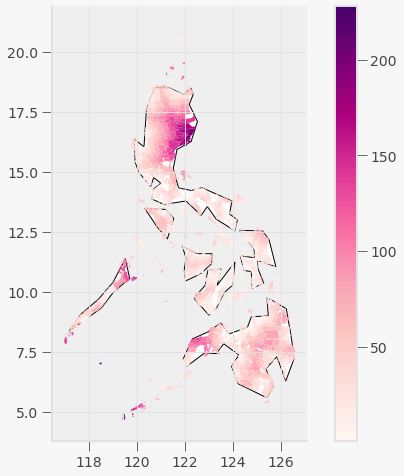

In [20]:
fig, gax = plt.subplots(figsize = (10,8))
#plot the Philippines!
world.query("name=='Philippines'").plot(ax=gax, edgecolor='black',color='white')


#plot the muicipalities
PHmerge.plot(ax=gax, column="d_s", legend=True,cmap='RdPu')

This above map displays the geographic distribution of my sea port data. There isn't anything too suspect here.

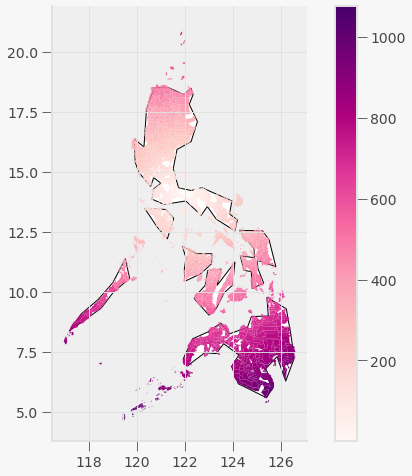

In [21]:
fig, gax = plt.subplots(figsize = (10,8))
#plot the Philippines!
world.query("name=='Philippines'").plot(ax=gax, edgecolor='black',color='white')


#plot the muicipalities
PHmerge.plot(ax=gax, column="d_a", legend=True,cmap='RdPu')

The above map displays the distance to airport variable is where I realised there was something wrong with my thesis data. The distance to airport variable is monotinically increasing the further south we go(which, among other things, would possibly violate the exclusion restriction since Duterte is from the south). This is a problem since I know for a fact that there are big airports in the southern most island group; the distance should be much smaller than what this map would imply. It was because I noticed this in the map that I was able to go back to my thesis data and realised that this instrument was constructed as the distance of each municipality to a specific airport, rather than its closest airport.

The next part of my final project is attempting to do some machine learning with my thesis data. I attempt to use neural networks and lasso  regressions. I explore the first stage and second stage of my instrumental variable regression analysis. I should note that(with the permission of Professor Schrimpf) I do not change my project data to the thesis data with the properly constructed instrument because doing so would require me to redo all the merge steps.

In [22]:
from sklearn import (
    linear_model, metrics, neural_network, pipeline, model_selection, preprocessing
)

from itertools import cycle


Second stage stage: The effect of fatalities on PDP vote share outcomes.

In [23]:
X=PHmerge.filter(["fatalities","population","d_a","d_s","a_earthquake","a_typhoon","p_2015"])

In [24]:
X

,fatalities,population,d_a,d_s,a_earthquake,a_typhoon,p_2015
0,6.0,48163.0,415.700943,43.021025,0.0,15.0,0.1027
1,0.0,3573.0,381.774094,78.005108,0.0,0.0,0.1884
2,1.0,17115.0,402.089528,56.601635,0.0,0.0,0.1583
3,0.0,2501.0,388.449210,71.571236,0.0,0.0,0.2102
4,0.0,2088.0,386.312373,76.900636,0.0,0.0,0.3034
...,...,...,...,...,...,...,...
1647,0.0,43646.0,711.059982,96.640363,0.0,0.0,0.4545
1648,0.0,41572.0,712.138555,107.335705,0.0,0.0,0.4619
1649,0.0,29969.0,756.128375,101.567757,0.0,0.0,0.5595
1650,0.0,49673.0,695.918439,115.040132,0.0,0.0,0.4591


In [25]:
y=PHmerge["PDPpercent"]


In [44]:
def fit_and_report_mses(mod, X_train, X_test, y_train, y_test):
    mod.fit(X_train, y_train)
    return dict(
        mse_train=metrics.mean_squared_error(y_train, mod.predict(X_train)),
        mse_test=metrics.mean_squared_error(y_test, mod.predict(X_test))
    )


In [45]:
#Lasso

X_train, X_test, y_train, y_test = model_selection.train_test_split(X, y, test_size=0.25)

mod = linear_model.Lasso()


In [49]:

##Still Lasso

fit_and_report_mses(mod, X_train, X_test, y_train, y_test)

#training MSE is directly thing that was minimized when fitting the model-> beta at
# predictions is xtest * beta hat

{'mse_train': 0.05249365952891098, 'mse_test': 0.05445826413891899}

Now I plot the observed PDP vote share and fatality data, and the training and testing data using the Lasso regression.

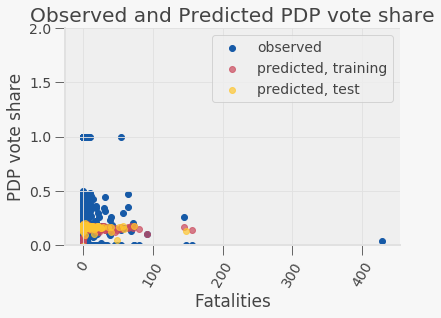

In [50]:
fig, ax = plt.subplots()
colors = qeds.themes.COLOR_CYCLE

ax.scatter(X["fatalities"],y, color=colors[0],label='observed')
ax.scatter(X_train["fatalities"],mod.predict(X_train), color=colors[1],alpha=0.7,label='predicted, training')
ax.scatter(X_test["fatalities"], mod.predict(X_test), color=colors[2], alpha=0.7, label='predicted, test')
ax.legend()
ax.set_ylim((0,2))
ax.set_title("Observed and Predicted PDP vote share")
ax.set_ylabel("PDP vote share")
ax.set_xlabel("Fatalities")
ax.xaxis.set_tick_params(rotation=60)

In [51]:
##switch to neural network
nn_scaled_model = pipeline.make_pipeline(
    preprocessing.StandardScaler(),  
    neural_network.MLPRegressor((30, 20))  
)

mod2=pipeline.make_pipeline(
    preprocessing.StandardScaler(),  # this will do the input scaling
    nn_scaled_model)       # put your favorite model here


mod2.fit(X,y)
dict(mse_train=metrics.mean_squared_error(y_train, mod2.predict(X_train)),
     mse_test=metrics.mean_squared_error(y_test, mod2.predict(X_test)))

{'mse_train': 0.049667363688345956, 'mse_test': 0.05209266516729703}

Now I plot the same data, this time using the Neural Network.

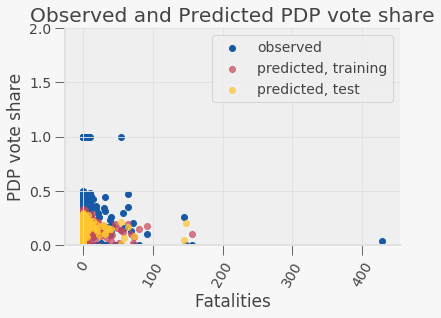

In [34]:
fig, ax = plt.subplots()
colors = qeds.themes.COLOR_CYCLE

ax.scatter(X["fatalities"],y, color=colors[0],label='observed')
ax.scatter(X_train["fatalities"],mod2.predict(X_train), color=colors[1],alpha=0.7,label='predicted, training')
ax.scatter(X_test["fatalities"],mod2.predict(X_test), color=colors[2], alpha=0.7, label='predicted, test')
ax.legend()
ax.set_ylim((0,2))
ax.set_title("Observed and Predicted PDP vote share")
ax.set_ylabel("PDP vote share")
ax.set_xlabel("Fatalities")
ax.xaxis.set_tick_params(rotation=60)

It would appear that the neural network does a slightly better job of predicting and fitting the second stage data.

First stage: Now I try to show how well my fatalities can be predicted by my IV set up, using the same models as above


If I understand it correctly, the MSEs are much higher than in the previous section because the units are larger, i.e. in the previous section the PDPpercent variable goes from 0 to 1 where as fatalities is a count of fatalities which goes from 0 to 428. So the much higher MSEs in the following section have mostly to do with the scaling of the dependent variable. I use the count of fatalities in the main specification in my thesis and that is what I think would be best to present here.


In [35]:
y2=PHmerge["fatalities"]
X2=PHmerge.filter(["population","d_a","d_s","a_earthquake","a_typhoon","p_2015"])

In [53]:
##Lasso

X_train, X_test, y_train, y_test = model_selection.train_test_split(X2,y2, test_size=0.25)



fit_and_report_mses(mod, X_train, X_test, y_train, y_test)

{'mse_train': 99.86755082232989, 'mse_test': 83.22227565742487}

Now I plot the observed fatalities along with BOTH my distance instruments(distance to seaports and distance to airports), and the training and testing data using the Lasso regression.

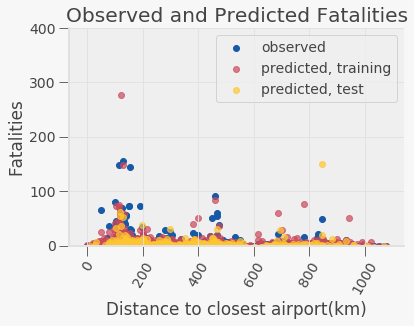

In [64]:
fig, ax = plt.subplots()
colors = qeds.themes.COLOR_CYCLE

ax.scatter(X2["d_a"],y2, color=colors[0],label='observed')
ax.scatter(X_train["d_a"],mod.predict(X_train), color=colors[1],alpha=0.7,label='predicted, training')
ax.scatter(X_test["d_a"], mod.predict(X_test), color=colors[2], alpha=0.7, label='predicted, test')
ax.legend()
ax.set_ylim((0,400))
ax.set_title("Observed and Predicted Fatalities")
ax.set_ylabel("Fatalities")
ax.set_xlabel("Distance to closest airport(km)")
ax.xaxis.set_tick_params(rotation=60)

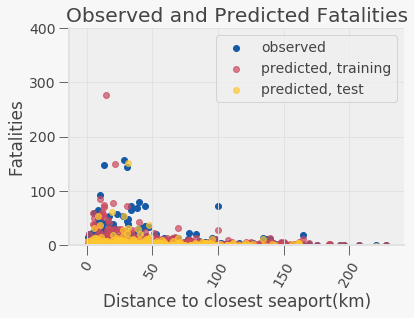

In [65]:
fig, ax = plt.subplots()
colors = qeds.themes.COLOR_CYCLE

ax.scatter(X2["d_s"],y2, color=colors[0],label='observed')
ax.scatter(X_train["d_s"],mod.predict(X_train), color=colors[1],alpha=0.7,label='predicted, training')
ax.scatter(X_test["d_s"], mod.predict(X_test), color=colors[2], alpha=0.7, label='predicted, test')
ax.legend()
ax.set_ylim((0,400))
ax.set_title("Observed and Predicted Fatalities")
ax.set_ylabel("Fatalities")
ax.set_xlabel("Distance to closest seaport(km)")
ax.xaxis.set_tick_params(rotation=60)

In [57]:
##switch to neural network

mod2.fit(X2,y2)
dict(mse_train=metrics.mean_squared_error(y_train, mod2.predict(X_train)),
     mse_test=metrics.mean_squared_error(y_test, mod2.predict(X_test)))

{'mse_train': 94.57821844145109, 'mse_test': 71.55170075782492}

I make the same plots with my instruments and the fatality data, using the neural networks

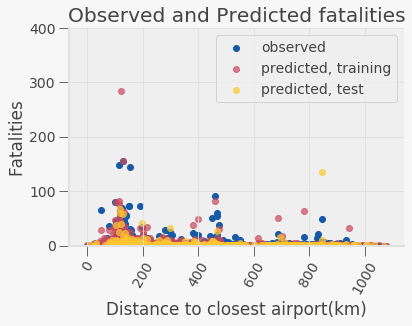

In [66]:
fig, ax = plt.subplots()
colors = qeds.themes.COLOR_CYCLE

ax.scatter(X2["d_a"],y2, color=colors[0],label='observed')
ax.scatter(X_train["d_a"],mod2.predict(X_train), color=colors[1],alpha=0.7,label='predicted, training')
ax.scatter(X_test["d_a"],mod2.predict(X_test), color=colors[2], alpha=0.7, label='predicted, test')
ax.legend()
ax.set_ylim((0,400))
ax.set_title("Observed and Predicted fatalities")
ax.set_ylabel("Fatalities")
ax.set_xlabel("Distance to closest airport(km)")
ax.xaxis.set_tick_params(rotation=60)

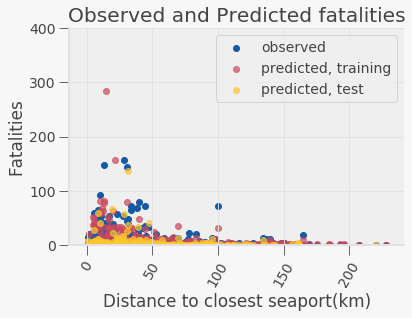

In [67]:
fig, ax = plt.subplots()
colors = qeds.themes.COLOR_CYCLE

ax.scatter(X2["d_s"],y2, color=colors[0],label='observed')
ax.scatter(X_train["d_s"],mod2.predict(X_train), color=colors[1],alpha=0.7,label='predicted, training')
ax.scatter(X_test["d_s"],mod2.predict(X_test), color=colors[2], alpha=0.7, label='predicted, test')
ax.legend()
ax.set_ylim((0,400))
ax.set_title("Observed and Predicted fatalities")
ax.set_ylabel("Fatalities")
ax.set_xlabel("Distance to closest seaport(km)")
ax.xaxis.set_tick_params(rotation=60)

To conclude, in the first stage, the neural network once again does a slightly better job than the lasso in fitting and predicting the data. Graphically, it looks like both models fit and predict the fatalities with the distance to airport slightly better than they do the distance to seaport. 

Thank you for reading my work and for a great semester! I learned a lot!